In [124]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_profiling as pp
import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_rows' , None)

from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import SVC
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder

import gensim

import scikitplot.plotters as skplt

import nltk

from xgboost import XGBClassifier

import os

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM
from keras.utils.np_utils import to_categorical
from keras.callbacks import ModelCheckpoint
from keras.models import load_model
from keras.optimizers import Adam

In [6]:
df = pd.read_csv('Ericsson_PredictiveAnalytics_Data.tar00679d2.gz', compression='gzip')

In [139]:
df[df['MaterialType']=="CR"]

,index,ID,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Creator,Subjects,Publisher,PublicationYear,MaterialType
1112,1112,1113.0,Physical,Horizon,2005,4,3,Japan : a travel survival kit.,NaN,Japan Guidebooks,Lonely Planet Publications,NaN,CR
1955,1955,1956.0,Physical,Horizon,2005,4,1,Cosmo Doogood's urban almanac.,NaN,Almanacs American,"E. Utne,",c2005-,CR
2378,2378,2379.0,Physical,Horizon,2005,4,1,Botswana.,NaN,Botswana Guidebooks,"Lonely Planet Publications,",2001-,CR
2949,2949,2950.0,Physical,Horizon,2005,4,1,The White House; an historic guide.,NaN,White House Washington D C,"White House Historical Association,",1962-,CR
3051,3051,3052.0,Physical,Horizon,2005,4,1,The Grants register.,NaN,"Research grants Directories, Scholarships Dire...",Palgrave Macmillan,c1969-,CR
3105,3105,3106.0,Physical,Horizon,2005,4,3,Quick escapes in the Pacific Northwest.,NaN,"Northwest Pacific Tours Periodicals, Northwest...","Globe Pequot Press,",c1991-,CR
3520,3520,3521.0,Physical,Horizon,2005,4,6,Rick Steves' Italy.,NaN,Italy Guidebooks,"John Muir Publications,",c1996-,CR
3983,3983,3984.0,Physical,Horizon,2005,4,8,Frommer's ... Los Angeles.,NaN,"Los Angeles Calif Guidebooks, Disneyland Calif...","Macmillan,",c1995-,CR
4039,4039,4040.0,Physical,Horizon,2005,4,2,Christmas ideas.,NaN,"Christmas decorations, Christmas cooking, Hand...",Special Interest Publications],NaN,CR
4421,4421,4422.0,Physical,Horizon,2005,4,2,Singapore.,NaN,Singapore Guidebooks,"Lonely Planet Publications,",1996-,CR


In [141]:
df['CheckoutYear'].value_counts()

2005            52755
CheckoutYear        1
Name: CheckoutYear, dtype: int64

In [10]:
df=df.rename(columns = {'train_file.csv':'ID'})

In [91]:
df.describe(include='all')

,index,ID,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Creator,Subjects,Publisher,PublicationYear,MaterialType
count,52764.000000,52761.000000,52763,52756,52756,52756,52756,52756,14515,49780,16613,16583,31653
unique,NaN,NaN,6,2,2,2,63,52756,10479,39838,5039,1174,8
top,NaN,NaN,Physical,Horizon,2005,4,1,Tea / a novel by Stacey D'Erasmo.,"Rylant, Cynthia",Feature films,"HarperCollins,",c2004.,BOOK
freq,NaN,NaN,52755,52755,52755,52755,31548,1,31,385,213,967,21707
mean,26381.500000,26378.600273,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,15231.799139,15228.439110,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,13190.750000,13191.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,26381.500000,26381.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,39572.250000,39565.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [64]:
df.shape

(52764, 13)

## INFO

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52764 entries, 0 to 52763
Data columns (total 12 columns):
ID                 52761 non-null float64
UsageClass         52763 non-null object
CheckoutType       52756 non-null object
CheckoutYear       52756 non-null object
CheckoutMonth      52756 non-null object
Checkouts          52756 non-null object
Title              52756 non-null object
Creator            14515 non-null object
Subjects           49780 non-null object
Publisher          16613 non-null object
PublicationYear    16583 non-null object
MaterialType       31653 non-null object
dtypes: float64(1), object(11)
memory usage: 4.8+ MB


## ISNULL

In [20]:
df.isnull().sum()

ID                     3
UsageClass             1
CheckoutType           8
CheckoutYear           8
CheckoutMonth          8
Checkouts              8
Title                  8
Creator            38249
Subjects            2984
Publisher          36151
PublicationYear    36181
MaterialType       21111
dtype: int64

## UNIQUE

In [12]:
df.nunique()

ID                 52755
UsageClass             6
CheckoutType           2
CheckoutYear           2
CheckoutMonth          2
Checkouts             63
Title              52756
Creator            10479
Subjects           39838
Publisher           5039
PublicationYear     1174
MaterialType           8
dtype: int64

### Material Type

In [13]:
df.MaterialType.unique()

array(['BOOK', 'SOUNDDISC', 'VIDEOCASS', 'VIDEODISC', 'SOUNDCASS',
       'MUSIC', 'MIXED', 'CR', nan], dtype=object)

In [14]:
df.MaterialType.value_counts()

BOOK         21707
SOUNDDISC     4149
VIDEOCASS     2751
VIDEODISC     1420
SOUNDCASS     1020
MIXED          347
MUSIC          165
CR              94
Name: MaterialType, dtype: int64

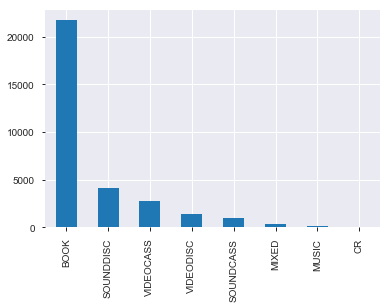

In [100]:
df['MaterialType'].value_counts().plot(kind="bar")

The Material Type,our output, looks very unbalanced. 

In [85]:
df.groupby('MaterialType').describe()

index                                                        \
                count          mean          std     min       25%      50%   
MaterialType                                                                  
BOOK          21707.0  15886.685355  9149.061671     0.0   7960.50  15907.0   
CR               94.0  15746.297872  8465.570635  1112.0   8844.25  15617.0   
MIXED           347.0  16665.141210  8852.470706   279.0   9279.00  16837.0   
MUSIC           165.0  17572.030303  8896.671252   241.0  11089.00  18538.0   
SOUNDCASS      1020.0  15680.694118  9208.734736    29.0   7875.00  15810.0   
SOUNDDISC      4149.0  15571.797301  9132.541939     9.0   7735.00  15378.0   
VIDEOCASS      2751.0  15739.647401  9086.492095    14.0   7722.00  15817.0   
VIDEODISC      1420.0  15510.065493  9135.480412    24.0   7563.75  15179.0   

                                      ID                                     \
                   75%      max    count          mean          std     min   
MaterialType                                                                  
BOOK          23864.50  31651.0  21707.0  15887.685355  9149.061671     1.0   
CR            22695.50  30518.0     94.0  15747.297872  8465.570635  1113.0   
MIXED         23970.50  31652.0    347.0  16666.141210  8852.470706   280.0   
MUSIC         24760.00  31435.0    165.0  17573.030303  8896.671252   242.0   
SOUNDCASS     23830.75  31639.0   1020.0  15681.694118  9208.734736    30.0   
SOUNDDISC     23278.00  31606.0   4149.0  15572.797301  9132.541939    10.0   
VIDEOCASS     23451.00  31649.0   2751.0  15740.647401  9086.492095    15.0   
VIDEODISC     23313.25  31650.0   1420.0  15511.065493  9135.480412    25.0   

                                                    
                   25%      50%       75%      max  
MaterialType                                        
BOOK           7961.50  15908.0  23865.50  31652.0  
CR             8845.25  15618.0  22696.50  30519.0  
MIXED          9280.00  16838.0  23971.50  31653.0  
MUSIC         11090.00  18539.0  24761.00  31436.0  
SOUNDCASS      7876.00  15811.0  23831.75  31640.0  
SOUNDDISC      7736.00  15379.0  23279.00  31607.0  
VIDEOCASS      7723.00  15818.0  23452.00  31650.0  
VIDEODISC      7564.75  15180.0  23314.25  31651.0

### Usage Class

In [59]:
df.UsageClass.unique()

array(['Physical', 'MaterialType', 'VIDEOCASS', 'BOOK', 'SOUNDDISC',
       'UsageClass', nan], dtype=object)

In [61]:
df.UsageClass.value_counts()

Physical        52755
VIDEOCASS           3
BOOK                2
UsageClass          1
MaterialType        1
SOUNDDISC           1
Name: UsageClass, dtype: int64

### Checkout Type

In [62]:
df.CheckoutType.unique()

array(['Horizon', nan, 'CheckoutType'], dtype=object)

In [63]:
df.CheckoutType.value_counts()

Horizon         52755
CheckoutType        1
Name: CheckoutType, dtype: int64

## Checkout Year

In [65]:
df.CheckoutYear.unique()

array(['2005', nan, 'CheckoutYear'], dtype=object)

In [66]:
df.CheckoutYear.value_counts()

2005            52755
CheckoutYear        1
Name: CheckoutYear, dtype: int64

## Checkout Month

In [67]:
df.CheckoutMonth.unique()

array(['4', nan, 'CheckoutMonth'], dtype=object)

In [68]:
df.CheckoutMonth.value_counts()

4                52755
CheckoutMonth        1
Name: CheckoutMonth, dtype: int64

### Checkouts

A count of the number of times the title was checked out within the “Checkout Month”

In [69]:
df.Checkouts.unique()

array(['1', '3', '4', '2', '16', '5', '6', '7', '8', '18', '9', '21',
       '10', '34', '12', '14', '15', '17', '13', '25', '11', '52', '20',
       '36', '84', '41', '27', '22', '45', '19', '39', '85', '28', '23',
       '44', '30', '78', '24', '31', '38', '61', '56', '29', '42', '26',
       '40', '37', '33', '35', '77', nan, 'Checkouts', '62', '137', '71',
       '32', '70', '46', '49', '43', '65', '50', '63', '47'], dtype=object)

In [70]:
df.Checkouts.value_counts()

1            31548
2             9653
3             4434
4             2555
5             1450
6              942
7              574
8              417
9              278
10             203
11             146
12             104
13              75
14              60
15              49
16              40
17              36
18              30
22              15
23              14
21              14
19              13
20              11
30               8
24               7
27               6
36               5
26               4
29               4
28               4
             ...  
45               3
37               3
56               3
39               2
35               2
31               2
52               2
33               2
46               2
32               2
38               2
40               2
65               1
71               1
62               1
137              1
44               1
85               1
42               1
43               1
63               1
49          

### Titles

In [76]:
df.Title.unique()              

# 52,756 out of 52,764 are unique values

# remaining 8 values are missing

array(['Tidal wave', 'London holiday / Richard Peck.',
       'Cinco de Mayo : celebrating Hispanic pride / Carol Gnojewski.',
       ..., "Sir Philip's folly / Marion Chesney.", 'Miss congeniality',
       'At his best [sound recording] / Bill Monroe.'], dtype=object)

In [77]:
df.Title.value_counts()[:5]

Tea / a novel by Stacey D'Erasmo.       1
Robert Ludlums The Cassandra compact    1
User centered web design                1
The English assassin / Daniel Silva.    1
Vegan virgin Valentine                  1
Name: Title, dtype: int64

### Creater

In [78]:
df.Creator.unique()

# 38,249 out of 52,764 values are missing (72% missing data)

array([nan, 'Peck, Richard, 1934-', 'Gnojewski, Carol', ...,
       'Hiort, Esbjørn', 'Sollers, Philippe, 1936-',
       'Garland, Michael, 1952-'], dtype=object)

### Subjects

In [79]:
df.Subjects.unique()

# 2,984 out of 52,764 values are missing (5.6% missing data)

# 39,838 out of 49,780‬ are unique values

array(['Tsunamis, Tsunamis Juvenile literature', nan,
       'Cinco de Mayo Mexican holiday History Juvenile literature, Mexican Americans Social life and customs Juvenile literature, Puebla Battle of Puebla de Zaragoza Mexico 1862 Juvenile literature, Cinco de Mayo Mexican holiday Juvenile literature, Holidays Juvenile literature, Mexico Social life and customs Juvenile literature',
       ..., 'Winter Fiction, Snow Juvenile fiction, Animals Fiction',
       'Books and reading Juvenile fiction, Teachers Juvenile fiction, Schools Fiction, Magic Fiction',
       'Man woman relationships England Fiction, Families England Fiction, Poor England Fiction, Regency fiction, Romance fiction'],
      dtype=object)

In [123]:
df.groupby(['MaterialType', 'Checkouts']).size()

MaterialType  Checkouts
BOOK          1            14619
              10              54
              11              41
              12              32
              13              13
              14              18
              15              17
              16              13
              17              12
              18              10
              19               2
              2             3760
              20               3
              21               4
              22               2
              23               2
              24               2
              26               2
              27               1
              28               1
              3             1388
              30               4
              31               1
              33               1
              34               1
              4              730
              41               1
              42               1
              5              404
              52   

In [86]:
df[df['CheckoutType'].isnull()]

,index,ID,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Creator,Subjects,Publisher,PublicationYear,MaterialType
31653,31653,NaN,MaterialType,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31654,31654,31654.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31655,31655,31655.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31656,31656,31656.0,BOOK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31657,31657,31657.0,SOUNDDISC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31658,31658,31658.0,BOOK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31659,31659,31659.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52763,52763,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


8 CheckoutType, CheckoutYear, CheckoutMonth, Checkouts and Title are missing from the whole dataset.

These datas are present in the test dataset

2 out of 3 ***NULL*** ID values are also present in this

In [88]:
pp.ProfileReport(df)

Number of variables,13
Number of observations,52764
Total Missing (%),19.6%
Total size in memory,5.2 MiB
Average record size in memory,104.0 B
Numeric,1
Categorical,11
Boolean,0
Date,0
Text (Unique),0
Rejected,1


In [89]:
pp.ProfileReport(train_df)

Number of variables,13
Number of observations,31653
Total Missing (%),16.7%
Total size in memory,3.4 MiB
Average record size in memory,112.0 B
Numeric,1
Categorical,6
Boolean,0
Date,0
Text (Unique),1
Rejected,5


In [90]:
pp.ProfileReport(test_df)

Number of variables,14
Number of observations,21111
Total Missing (%),22.3%
Total size in memory,2.3 MiB
Average record size in memory,112.0 B
Numeric,1
Categorical,10
Boolean,0
Date,0
Text (Unique),0
Rejected,3


In [23]:
df[df.MaterialType.isnull()]

,ID,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Creator,Subjects,Publisher,PublicationYear,MaterialType
31653,NaN,MaterialType,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31654,31654.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31655,31655.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31656,31656.0,BOOK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31657,31657.0,SOUNDDISC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31658,31658.0,BOOK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31659,31659.0,VIDEOCASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31660,NaN,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Creator,Subjects,Publisher,PublicationYear,NaN
31661,31654.0,Physical,Horizon,2005,4,1,Footprints at the window,NaN,"England Fiction, Space and time Fiction",NaN,NaN,NaN
31662,31655.0,Physical,Horizon,2005,4,2,Seven brides for seven brothers,NaN,"Video recordings for the hearing impaired, Mus...",NaN,NaN,NaN


In [31]:
df.reset_index(inplace=True)

In [33]:
df.columns

Index(['index', 'ID', 'UsageClass', 'CheckoutType', 'CheckoutYear',
       'CheckoutMonth', 'Checkouts', 'Title', 'Creator', 'Subjects',
       'Publisher', 'PublicationYear', 'MaterialType'],
      dtype='object')

In [36]:
test_df = df[df.index >= 31653]

In [37]:
train_df = df[df.index < 31653]

In [54]:
train_df.shape

(31653, 13)

In [39]:
train_df.isnull().sum()

index                  0
ID                     0
UsageClass             0
CheckoutType           0
CheckoutYear           0
CheckoutMonth          0
Checkouts              0
Title                  0
Creator            23137
Subjects            1763
Publisher          21916
PublicationYear    21931
MaterialType           0
dtype: int64

In [56]:
test_df.shape

(21111, 13)

In [55]:
test_df.isnull().sum()

index                  0
ID                     3
UsageClass             1
CheckoutType           8
CheckoutYear           8
CheckoutMonth          8
Checkouts              8
Title                  8
Creator            15112
Subjects            1221
Publisher          14235
PublicationYear    14250
MaterialType       21111
dtype: int64

In [129]:
train_df

,index,ID,UsageClass,CheckoutType,CheckoutYear,CheckoutMonth,Checkouts,Title,Subjects,MaterialType
0,0,1.0,Physical,Horizon,2005,4,1,Tidal wave,"Tsunamis, Tsunamis Juvenile literature",BOOK
1,1,2.0,Physical,Horizon,2005,4,1,London holiday / Richard Peck.,NaN,BOOK
2,2,3.0,Physical,Horizon,2005,4,3,Cinco de Mayo : celebrating Hispanic pride / C...,Cinco de Mayo Mexican holiday History Juvenile...,BOOK
3,3,4.0,Physical,Horizon,2005,4,1,Annapolis,"War stories, Historical fiction, Domestic fict...",BOOK
4,4,5.0,Physical,Horizon,2005,4,1,As a man thinketh,Thought and thinking,BOOK
5,5,6.0,Physical,Horizon,2005,4,4,Minnie and Moo go dancing / [written and illus...,"Cows Juvenile fiction, Parties Fiction, Farm l...",BOOK
6,6,7.0,Physical,Horizon,2005,4,1,cat who robbed a bank,"Mystery fiction, Qwilleran Jim Fictitious char...",BOOK
7,7,8.0,Physical,Horizon,2005,4,1,Irwin guide to using the Wall Street journal,"Wall Street journal, Investments United States...",BOOK
8,8,9.0,Physical,Horizon,2005,4,4,Oracle night,Novelists American New York State New York Fic...,BOOK
9,9,10.0,Physical,Horizon,2005,4,1,12 haunted episodes,Rock music 1991 2000,SOUNDDISC
